<h1> Three Layer Code Testing </h1>

Notebook containing preliminary code formulation for the multilayer scattering problem.  Code is written for three layers, and will include tests to verify the following:

<ol>
    <li> Inward Representation of $D_{ii}$ and $S_{ii}$ 
    <li> Outward Representation of $D_{ii+1}$ and $S_{ii+1}$
    <li> Usage of Factorized PTR vs Original Loops for representation of layer and boundary data</li>
</ol>

This notebook will be using our revised notation for the multilayer problem, which will also be used in the final notebook for $N$ layers.

<h3>Imports</h3>

In [1]:
%matplotlib inline
import sympy as sp
import numpy as np
from sympy import cos, sin, exp
from numpy import sqrt, log
from scipy.special import hankel1
from scipy.special import jv as besselj
from scipy.linalg import toeplitz
from matplotlib import pyplot as plt
from numpy import vectorize
from mpl_toolkits.mplot3d import Axes3D

from Boundary import *
from essentials import *

# For plotly plots
from plotly.offline import plot, iplot, init_notebook_mode
from plotly.graph_objs import *
init_notebook_mode()
init_notebook_mode(connected=True)
from IPython.display import HTML

import warnings
warnings.filterwarnings('ignore')

<h3>Formulation of Matrix System</h3>

For three layers, we have the following system of equations:

$u_{00}(x) = u^{in}(x) + D_{00}[u_{00}](x) - S_{00}[\partial{n_0}u_{00}](x)$

$u_{01}(x) = S_{01}[\partial n_0 u_{01}](x) - D_{01}[u_{01}](x)$

$u_{11}(x) = u^{\infty}_1(x) + D_{11}[u_{11}](x) - S_{11}[\partial{n_1}u_{11}](x)$

$u_{12}(x) = S_{12}[\partial n_1 u_{12}](x) - D_{12}[u_{12}](x)$

<br>
On the boundary, we can represent the solutions as:

$\frac{1}{2}u_{00}(x^b_0) = u^{in}(x^b_0) + D_{00}[u_{00}](x^b_0) - S_{00}[\partial{n_0}u_{00}](x^b_0)$

$\frac{1}{2}u_{01}(x^b_0) = S_{01}[\partial n_0 u_{01}](x^b_0) - D_{01}[u_{01}](x^b_0)$

$\frac{1}{2}u_{11}(x^b_1) = u^{\infty}_1(x^b_1) + D_{11}[u_{11}](x^b_1) - S_{11}[\partial{n_1}u_{11}](x^b_1)$

$\frac{1}{2}u_{12}(x^b_1) = S_{12}[\partial n_1 u_{12}](x^b_1) - D_{12}[u_{12}](x^b_1)$

<br>
To represent $u^{\infty}_1(x^b_1)$ we use the Outward Representation such that $u^{\infty}_1(x) = u_{01}(x)$.  This gives us the following:

$u^{\infty}_1(x^b_1) = S_{01}[\partial n_0 u_{01}](x^b_1) - D_{01}[u_{01}](x^b_1) = \frac{\varepsilon_1}{\varepsilon_0}S_{01}[\partial n_0 u_{00}](x^b_1) - D_{01}[u_{00}](x^b_1)$

<br>
For our representation of $u_{01}(x)$, we assume there is some back-scattering.  We would say it comes from $L_1$ off of $\Gamma_1$, so we use an identity based on $u_{11}(x)$ to represent it.  Say it is the following:

$u^{bs}_{0} = D_{11}[u_{11}](x) - S_{11}[\partial n_1 u_{11}](x)$

<br>
Using this, our full system representation is:

$u_{00}(x) = u^{in}(x) + D_{00}[u_{00}](x) - S_{00}[\partial n_0 u_{00}](x)$

$u_{01}(x) = \frac{\varepsilon_1}{\varepsilon_0} S_{01}[\partial n_0 u_{00}](x) - D_{01}[u_{00}](x) + D_{11}[u_{11}](x) - S_{11}[\partial n_1 u_{11}](x)$

$u_{11}(x) = \frac{\varepsilon_1}{\varepsilon_0} S_{01}[\partial n_0 u_{00}](x) - D_{01}[u_{00}](x) + D_{11}[u_{11}](x) - S_{11}[\partial n_1 u_{11}](x)$

$u_{12}(x) = \frac{\varepsilon_2}{\varepsilon_1} S_{12}[\partial n_1 u_{11}](x) - D_{12}[u_{11}](x)$

<br>
On the boundary, our system representation is:

$\frac{1}{2}u_{00}(x^b_0) = u^{in}(x^b_0) + D_{00}[u_{00}](x^b_0) - S_{00}[\partial{n_0}u_{00}](x^b_0)$

$\frac{1}{2}u_{00}(x^b_0) = \frac{\varepsilon_1}{\varepsilon_0}S_{01}[\partial n_0 u_{00}](x^b_0) - D_{01}[u_{00}](x^b_0) + D_{11}[u_11](x^b_0) - S_{11}[\partial n_1 u_{11}](x^b_0)$

$\frac{1}{2}u_{11}(x^b_1) = \frac{\varepsilon_1}{\varepsilon_0}S_{01}[\partial n_0 u_{00}](x^b_1) - D_{01}[u_{00}](x^b_1) + D_{11}[u_{11}](x^b_1) - S_{11}[\partial{n_1}u_{11}](x^b_1)$

$\frac{1}{2}u_{11}(x^b_1) = \frac{\varepsilon_2}{\varepsilon_1}S_{12}[\partial n_1 u_{11}](x^b_1) - D_{12}[u_{11}](x^b_1)$

<br>
Applying the transmission conditions on each boundary, we can write each of these as solvable matrix systems.


$\begin{bmatrix}\frac{I}{2} - D_{00}(x^b_0) & S_{00}(x^b_0) & 0 & 0 \\ \frac{I}{2} + D_{01}(x^b_0) & \frac{-\varepsilon_1}{\varepsilon_0}S_{01}(x^b_0) & -D_{11}(x^b_0) & S_{11}(x^b_0) \\ D_{01}(x^b_1) & \frac{-\varepsilon_1}{\varepsilon_0}S_{01}(x^b_1) & \frac{I}{2} - D_{11}(x^b_1) & S_{11}(x^b_1) \\ 0 & 0 & \frac{I}{2} + D_{12}(x^b_1) & \frac{-\varepsilon_2}{\varepsilon_1}S_{12}(x^b_1)\end{bmatrix}\begin{bmatrix}u_{00}(x^b_0) \\ \partial n_0 u_{00}(x^b_0) \\ u_{11}(x^b_1) \\ \partial n_1 u_{11} (x^b_1)\end{bmatrix} = \begin{bmatrix}u^{in}(x^b_0) \\ 0 \\ 0 \\ 0\end{bmatrix}$

<br>

One of our tests will be to verify that these systems give us the same values for $u_{00}$, $\partial n_0 u_{00}$, $u_{11}$, and $\partial n_1 u_{11}$.

<h3> Define Boundaries </h3>

In [2]:
t = sp.Symbol('t')
#Circle1 = (4*cos(t), 4*sin(t))
#Circle2 = ((4 - (2*np.pi)/5)*cos(t), (4 - (2*np.pi)/5)*sin(t))

Circle1 = (6*cos(t), 6*sin(t))
Circle2 = (4*cos(t), 4*sin(t))

C1 = Boundary(Circle1)
C2 = Boundary(Circle2)
lclassB(C1)
lclassB(C2)

Bdys = [C1, C2]

In [3]:
M = 300
ks = [3, 3, 3]
alpha = 0
ngrid = 150

dt = 2.0 * np.pi/M
θ = np.arange(0, 2*np.pi, dt)
layers = 3

Mvals = [M, M]
nvals = [ngrid, ngrid, ngrid]
Ds = [2, 2]

xbdys, ybdys, xs, ys = fullmake_grid(Mvals, nvals, Bdys, Ds)

xbdy0, ybdy0 = xbdys[0], ybdys[0]
xbdy1, ybdy1 = xbdys[1], ybdys[1]
x0, y0 = xs[0], ys[0]
x1, y1 = xs[1], ys[1]
x2, y2 = xs[2], ys[2]

<h4>Find $D_{00}(x^b_0)$, $S_{00}(x^b_0)$, $D_{01}(x^b_0)$, $S_{01}(x^b_0)$, and $u^{in}(x^b_0)$</h4>



In [4]:
r_distance = np.zeros((M, M))
θ_diff = np.zeros((M, M))
cosθ = np.zeros((M, M))

ν = C1.ν_l(θ)
J = C1.J_l(θ)
κ = C1.κ_l(θ)
E_C =  np.euler_gamma

N = M / 2
m = np.arange(1, N)

# Create array for ifft
a = [0]
a.extend(1/m)
a.append(1/N)
a.extend((1/m)[::-1])

Rj = -2 * np.pi * np.fft.ifft(a)
R = np.real(toeplitz(Rj, Rj))
# Reduced double for-loop to single, vectorized
for m in range(0, M):
        r_diff = np.asarray([xbdy0[m] - xbdy0, ybdy0[m] - ybdy0])
        r_distance[:,m] = sqrt(r_diff[0]**2 + r_diff[1]**2)
        θ_diff[:,m] = m - np.arange(0,M)
        r_distance[m,m] = 1
        cosθ[:,m] = (ν[0]*r_diff[0] + ν[1]*r_diff[1])/r_distance[:,m]
        
# This r_distance matrix will have 0s on diagonal.  Singularity here requires usage of Kress Quadrature
# We do not use diagonal values of r_distance or θ_diff, so can replace 1s to prevent
#    singularity in the following bessel and hankel func arrays
diag = np.arange(0,M)
θ_diff[diag, diag] = θ_diff[diag, diag] + 1
logterms = log(4*np.sin(0.5 * θ_diff * dt)**2)

besselj_00 = besselj(0, ks[0] * r_distance)
besselj_01 = besselj(1, ks[0] * r_distance)
hankel1_00 = hankel1(0, ks[0] * r_distance)
hankel1_01 = hankel1(1, ks[0] * r_distance)

D00_1 = 0.5 * ks[0] / np.pi * J * cosθ * besselj_01
D00_2 = 0.5 * 1j * ks[0] * J * cosθ * hankel1_01 - D00_1 * logterms
S00_1 = -0.5 / np.pi * J * besselj_00
S00_2 = 0.5 * 1j * J * hankel1_00 - S00_1 * logterms

D00_1[diag, diag] = 0 # besselj_01 = 0 on diagonal
D00_2[diag, diag] = 0.5 / np.pi * κ * J
S00_1[diag, diag] = -0.5 / np.pi * J  # besselj_00 = 1 on diagonal
S00_2[diag, diag] = J * (0.5 * 1j - E_C / np.pi * np.log( 0.25 * (ks[0]**2) * J**2))

D00 = 0.5 * R * D00_1 + (np.pi / M) * D00_2
S00 = 0.5 * R * S00_1 + (np.pi / M) * S00_2

uin_0 = find_exact_planewave(xbdy0, ybdy0, ks[0], alpha)

besselj_10 = besselj(0, ks[1] * r_distance)
besselj_11 = besselj(1, ks[1] * r_distance)
hankel1_10 = hankel1(0, ks[1] * r_distance)
hankel1_11 = hankel1(1, ks[1] * r_distance)

D01_1 = 0.5 * ks[1] / np.pi * J * cosθ * besselj_11
D01_2 = 0.5 * 1j * ks[1] * J * cosθ * hankel1_01 - D01_1 * logterms
S01_1 = -0.5 / np.pi * J * besselj_10
S01_2 = 0.5 * 1j * J * hankel1_10 - S01_1 * logterms

D01_1[diag, diag] = 0 # besselj_01 = 0 on diagonal
D01_2[diag, diag] = 0.5 / np.pi * κ * J
S01_1[diag, diag] = -0.5 / np.pi * J  # besselj_00 = 1 on diagonal
S01_2[diag, diag] = J * (0.5 * 1j - E_C / np.pi * np.log( 0.25 * (ks[1]**2) * J**2))

D01 = 0.5 * R * D01_1 + (np.pi / M) * D01_2
S01 = 0.5 * R * S01_1 + (np.pi / M) * S01_2

<h4>Find $D_{11}(x^b_0)$, $S_{11}(x^b_0)$</h4>

In [5]:
r_distance = np.zeros((M, M))
#θ_diff = np.zeros((M, M))  Already defined earlier
cosθ = np.zeros((M, M))

ν = C2.ν_l(θ) # Based on first index of D and S
J = C2.J_l(θ) # Based on first index of D and S

for m in range(0, M):
        r_diff = np.asarray([xbdy0[m] - xbdy1, ybdy0[m] - ybdy1]) # Change here
        # xbdy0 - Based on first index of D and S
        # xbdy1 - Based on input of D and S
        # No r_diff = 0 in this case
        r_distance[:][m] = sqrt(r_diff[0]**2 + r_diff[1]**2)
        #θ_diff[:][m] = m - np.arange(0,M) Already defined earlier // Do not change for same M
        #r_distance[m][m] = 1  Do not need to prevent singularity here
        cosθ[:][m] = (ν[0]*r_diff[0] + ν[1]*r_diff[1])/r_distance[:][m]
        
# Inward representation
D11_I = (np.pi / M) * 0.5 * 1j * ks[1] * cosθ * J * hankel1(1, ks[1] * r_distance)
S11_I = (np.pi / M) * 0.5 * 1j * J * hankel1(0, ks[1] * r_distance)

<h4>Find $D_{01}(x^b_1)$, and $S_{01}(x^b_1)$</h4>

In [6]:
r_distance = np.zeros((M, M))
#θ_diff = np.zeros((M, M))  Already defined earlier
cosθ = np.zeros((M, M))

ν = C1.ν_l(θ) # Based on first index of D and S
J = C1.J_l(θ) # Based on first index of D and S

for m in range(0, M):
        r_diff = np.asarray([xbdy1[m] - xbdy0, ybdy1[m] - ybdy0]) # Change here
        # xbdy0 - Based on first index of D and S
        # xbdy1 - Based on input of D and S
        # No r_diff = 0 in this case
        r_distance[:][m] = sqrt(r_diff[0]**2 + r_diff[1]**2)
        #θ_diff[:][m] = m - np.arange(0,M) Already defined earlier // Do not change for same M
        #r_distance[m][m] = 1  Do not need to prevent singularity here
        cosθ[:][m] = (ν[0]*r_diff[0] + ν[1]*r_diff[1])/r_distance[:][m]
        
# Outward representation
D01_O = (np.pi / M) * 0.5 * 1j * ks[1] * cosθ * J * hankel1(1, ks[1] * r_distance)
S01_O = (np.pi / M) * 0.5 * 1j * J * hankel1(0, ks[1] * r_distance)

<h4>Find $D_{11}(x^b_1)$, $S_{11}(x^b_1)$, $D_{12}(x^b_1)$, and $S_{12}(x^b_1)$</h4>

In [7]:
r_distance = np.zeros((M, M))
#θ_diff = np.zeros((M, M))  Already defined earlier
cosθ = np.zeros((M, M))

ν = C2.ν_l(θ) # Change here
J = C2.J_l(θ) # Change here
κ = C2.κ_l(θ) # Change here
#E_C =  np.euler_gamma Already defined earlier

# None of the below changes unless M changes

N = M / 2
m = np.arange(1, N)

# Create array for ifft
a = [0]
a.extend(1/m)
a.append(1/N)
a.extend((1/m)[::-1])

Rj = -2 * np.pi * np.fft.ifft(a)
R = np.real(toeplitz(Rj, Rj))
# Reduced double for-loop to single
for m in range(0, M):
        r_diff = np.asarray([xbdy1[m] - xbdy1, ybdy1[m] - ybdy1]) # Change here
        r_distance[:,m] = sqrt(r_diff[0]**2 + r_diff[1]**2)
        #θ_diff[:][m] = m - np.arange(0,M) Already defined earlier // Do not change for same M
        r_distance[m,m] = 1
        cosθ[:,m] = (ν[0]*r_diff[0] + ν[1]*r_diff[1])/r_distance[:,m]
        
#diag = np.arange(0,M) Already defined earlier
#θ_diff[diag, diag] = θ_diff[diag, diag] + 1 Already defined earlier
#logterms = log(4*np.sin(0.5 * θ_diff * dt)**2) Already defined earlier

# Many changes below

besselj_10 = besselj(0, ks[1] * r_distance)
besselj_11 = besselj(1, ks[1] * r_distance)
hankel1_10 = hankel1(0, ks[1] * r_distance)
hankel1_11 = hankel1(1, ks[1] * r_distance)

D11_1 = 0.5 * ks[1] / np.pi * J * cosθ * besselj_11
D11_2 = 0.5 * 1j * ks[1] * J * cosθ * hankel1_11 - D11_1 * logterms
S11_1 = -0.5 / np.pi * J * besselj_10
S11_2 = 0.5 * 1j * J * hankel1_10 - S11_1 * logterms

D11_1[diag, diag] = 0 # besselj_01 = 0 on diagonal
D11_2[diag, diag] = 0.5 / np.pi * κ * J
S11_1[diag, diag] = -0.5 / np.pi * J  # besselj_00 = 1 on diagonal
S11_2[diag, diag] = J * (0.5 * 1j - E_C / np.pi * np.log( 0.25 * (ks[1]**2) * J**2))

D11 = 0.5 * R * D11_1 + (np.pi / M) * D11_2
S11 = 0.5 * R * S11_1 + (np.pi / M) * S11_2

uin_1 = find_exact_planewave(xbdy1, ybdy1, ks[1], alpha)

besselj_20 = besselj(0, ks[2] * r_distance)
besselj_21 = besselj(1, ks[2] * r_distance)
hankel1_20 = hankel1(0, ks[2] * r_distance)
hankel1_21 = hankel1(1, ks[2] * r_distance)

D12_1 = 0.5 * ks[2] / np.pi * J * cosθ * besselj_21
D12_2 = 0.5 * 1j * ks[2] * J * cosθ * hankel1_21 - D12_1 * logterms
S12_1 = -0.5 / np.pi * J * besselj_20
S12_2 = 0.5 * 1j * J * hankel1_20 - S12_1 * logterms

D12_1[diag, diag] = 0 # besselj_01 = 0 on diagonal
D12_2[diag, diag] = 0.5 / np.pi * κ * J
S12_1[diag, diag] = -0.5 / np.pi * J  # besselj_00 = 1 on diagonal
S12_2[diag, diag] = J * (0.5 * 1j - E_C / np.pi * np.log( 0.25 * (ks[2]**2) * J**2))

D12 = 0.5 * R * D12_1 + (np.pi / M) * D12_2
S12 = 0.5 * R * S12_1 + (np.pi / M) * S12_2

In [8]:
A = np.zeros((4*M, 4*M), dtype=complex)
F = np.zeros(4*M, dtype=complex)
G = np.zeros(4*M, dtype=complex)

# For A and B, we already have A00, A01, A10, and A11

# Inward Representation - A
A00 = 0.5 * np.identity(M) - D00
A01 = S00

A10 = 0.5 * np.identity(M) + D01
A11 = -(ks[1]/ks[0])**2 * S01
A12 = -D11_I
A13 = S11_I

A20 = D01_O
A21 = -(ks[1]/ks[0])**2 * S01_O
A22 = 0.5 * np.identity(M) - D11
A23 = S11

A32 = 0.5 * np.identity(M) + D12
A33 = -(ks[2]/ks[1])**2 * S12

A[0:M, 0:M] = A00; A[0:M, M: 2*M] = A01

A[M: 2*M, 0:M] = A10; A[M: 2*M, M: 2*M] = A11
A[M:2*M, 2*M:3*M] = A12; A[M:2*M, 3*M:4*M] = A13

A[2*M:3*M, 0:M] = A20; A[2*M:3*M, M:2*M] = A21
A[2*M:3*M, 2*M:3*M] = A22; A[2*M:3*M, 3*M:4*M] = A23

A[3*M:4*M, 2*M:3*M] = A32; A[3*M:4*M, 3*M:4*M] = A33

F[0:M] = uin_0

# Solve both
U = np.linalg.solve(A, F)

u00 = U[0:M]; dvu00 = U[M:2*M]; u11 = U[2*M:3*M]; dvu11 = U[3*M:4*M]

<h3>Validate $u_{00}(x^b_0)$ and $\partial n_0 u_{00}(x^b_0)$</h3>

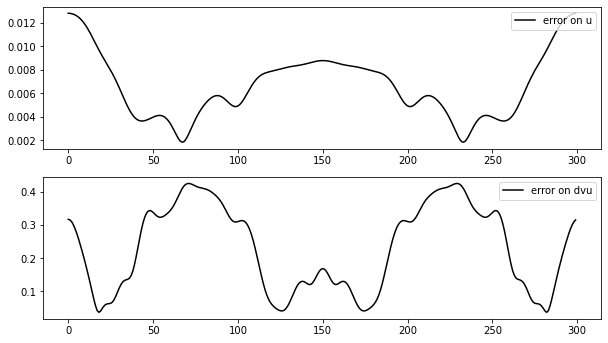

In [9]:
f0 = find_exact_planewave(xbdy0, ybdy0, ks[0], alpha)
df0 = [1j * ks[0] * np.cos(alpha) * np.exp(1j * ks[0] * (np.cos(alpha) * xbdy0 + np.sin(alpha) * ybdy0)), 1j * ks[0] * np.sin(alpha) * np.exp(1j * ks[0] * (np.cos(alpha) * xbdy0 + np.sin(alpha) * ybdy0))]
dvf0 = C1.ν_l(θ)[0] * df0[0] + C1.ν_l(θ)[1] * df0[1]

fig = plt.figure(figsize=(10, 12))
ax1 = fig.add_subplot(411)
ax1.plot(np.abs(u00 - f0), 'k', label='error on u')
#ax1.plot(np.abs(f0), 'c--', label='Exact')
ax1.legend(loc='upper right')

ax2 = fig.add_subplot(412)
ax2.plot(np.abs(dvu00 - dvf0), 'k', label='error on dvu')
#ax2.plot(np.abs(dvf0), 'c--', label='Exact')
ax2.legend(loc='upper right')

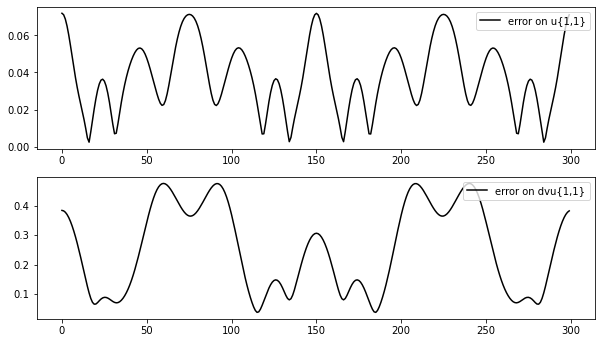

In [10]:
f1 = find_exact_planewave(xbdy1, ybdy1, ks[1], alpha)
df1 = [1j * ks[1] * np.cos(alpha) * np.exp(1j * ks[1] * (np.cos(alpha) * xbdy1 + np.sin(alpha) * ybdy1)), 1j * ks[1] * np.sin(alpha) * np.exp(1j * ks[1] * (np.cos(alpha) * xbdy1 + np.sin(alpha) * ybdy1))]
dvf1 = C1.ν_l(θ)[0] * df1[0] + C1.ν_l(θ)[1] * df1[1]

fig = plt.figure(figsize=(10, 12))
ax1 = fig.add_subplot(411)
ax1.plot(np.abs(u11 - f1), 'k', label='error on u{1,1}')
#ax1.plot(np.abs(f1), 'c--', label='Exact')
ax1.legend(loc='upper right')

ax2 = fig.add_subplot(412)
ax2.plot(np.abs(dvu11 - dvf1), 'k', label='error on dvu{1,1}')
#ax2.plot(np.abs(dvf1), 'c--', label='Exact')
ax2.legend(loc='upper right')

In [11]:
u00 = f0
u11 = f1
dvu00 = dvf0
dvu11 = dvf1

In [12]:
vs = []
D00_mn = np.zeros((M + 1, ngrid), dtype=complex)
S00_mn = np.zeros((M + 1, ngrid), dtype=complex)
D01_mn = np.zeros((M + 1, ngrid), dtype=complex)
S01_mn = np.zeros((M + 1, ngrid), dtype=complex)

D11_O_mn = np.zeros((M + 1, ngrid), dtype=complex)
S11_O_mn = np.zeros((M + 1, ngrid), dtype=complex)

ν1 = C1.ν_l(θ)
J1 = C1.J_l(θ)

ν2 = C1.ν_l(θ)
J2 = C1.J_l(θ)

for m in range(0,M + 1):
    for n in range(0, ngrid):
        x1_diff = x0[m][n] - xbdy0
        y1_diff = y0[m][n] - ybdy0
        distance1 = sqrt(x1_diff**2 + y1_diff**2)
        cosθ1 = (ν1[0][:]*x1_diff + ν1[1][:]*y1_diff) / distance1
        
        kernelD00 = 0.25 * 1j * ks[0] * cosθ1 * hankel1(1, ks[0]*distance1)
        kernelS00 = 0.25 * 1j * hankel1(0, ks[0]*distance1)
        
        D00_mn[m][n] = sum(kernelD00 * J1 * u00) * dt
        S00_mn[m][n] = sum(kernelS00 * J1 * dvu00) * dt
        
        x2_diff = x1[m][n] - xbdy0
        y2_diff = y1[m][n] - ybdy0
        distance2 = sqrt(x2_diff**2 + y2_diff**2)
        cosθ2 = (ν1[0][:]*x2_diff + ν1[1][:]*y2_diff) / distance2
        
        kernelD01 = 0.25 * 1j * ks[1] * cosθ2 * hankel1(1, ks[1]*distance2)
        kernelS01 = 0.25 * 1j * hankel1(0, ks[1]*distance2)
        
        D01_mn[m][n] = sum(kernelD01 * J1 * u00) * dt
        S01_mn[m][n] = sum(kernelS01 * J1 * dvu00) * dt
        
        x3_diff = x1[m][n] - xbdy1
        y3_diff = y1[m][n] - ybdy1
        distance3 = sqrt(x3_diff**2 + y3_diff**2)
        cosθ3 = (ν2[0][:]*x3_diff + ν2[1][:]*y3_diff) / distance3
        
        kernelD11 = 0.25 * 1j * ks[1] * cosθ3 * hankel1(1, ks[1]*distance3)
        kernelS11 = 0.25 * 1j * hankel1(0, ks[1]*distance3)
        
        D11_O_mn[m][n] = sum(kernelD11 * J2 * u11) * dt
        S11_O_mn[m][n] = sum(kernelS11 * J2 * dvu11) * dt

f = find_exact_planewave(x0, y0, ks[0], alpha)
v0 = f + D00_mn - S00_mn
v1 = (ks[1]/ks[0])**2 * S01_mn - D01_mn + D11_O_mn - S11_O_mn

In [13]:
D01_mn = np.zeros((M + 1, ngrid), dtype=complex)
S01_mn = np.zeros((M + 1, ngrid), dtype=complex)
D11_mn = np.zeros((M + 1, ngrid), dtype=complex)
S11_mn = np.zeros((M + 1, ngrid), dtype=complex)
D12_mn = np.zeros((M + 1, ngrid), dtype=complex)
S12_mn = np.zeros((M + 1, ngrid), dtype=complex)


ν1 = C1.ν_l(θ)
J1 = C1.J_l(θ)

ν2 = C2.ν_l(θ)
J2 = C2.J_l(θ)

# OUTWARD REPRESENTATION
for m in range(0,M + 1):
    for n in range(0, ngrid):
        
        x1_diff = x1[m][n] - xbdy0
        y1_diff = y1[m][n] - ybdy0
        distance1 = sqrt(x1_diff**2 + y1_diff**2)
        cosθ1 = (ν1[0][:]*x1_diff + ν1[1][:]*y1_diff) / distance1
        
        kernelD01 = 0.25 * 1j * ks[1] * cosθ1 * hankel1(1, ks[1]*distance1)
        kernelS01 = 0.25 * 1j * hankel1(0, ks[1]*distance1)
        
        D01_mn[m][n] = sum(kernelD01 * J1 * u00) * dt
        S01_mn[m][n] = sum(kernelS01 * J1 * dvu00) * dt
        
        x2_diff = x1[m][n] - xbdy1
        y2_diff = y1[m][n] - ybdy1
        distance2 = sqrt(x2_diff**2 + y2_diff**2)
        cosθ2 = (ν2[0][:]*x2_diff + ν2[1][:]*y2_diff) / distance2
        
        kernelD11 = 0.25 * 1j * ks[1] * cosθ2 * hankel1(1, ks[1]*distance2)
        kernelS11 = 0.25 * 1j * hankel1(0, ks[1]*distance2)
        
        D11_mn[m][n] = sum(kernelD11 * J2 * u11) * dt
        S11_mn[m][n] = sum(kernelS11 * J2 * dvu11) * dt
        
        x3_diff = x2[m][n] - xbdy1
        y3_diff = y2[m][n] - ybdy1
        distance3 = sqrt(x3_diff**2 + y3_diff**2)
        cosθ3 = (ν2[0][:]*x3_diff + ν2[1][:]*y3_diff) / distance3
        
        kernelD12 = 0.25 * 1j * ks[2] * cosθ3 * hankel1(1, ks[2]*distance3)
        kernelS12 = 0.25 * 1j * hankel1(0, ks[2]*distance3)
        
        D12_mn[m][n] = sum(kernelD12 * J2 * u11) * dt
        S12_mn[m][n] = sum(kernelS12 * J2 * dvu11) * dt

vinf = (ks[1]/ks[0])**2 * S01_mn - D01_mn + D11_mn - S11_mn
v2 = (ks[2]/ks[1])**2 * S12_mn - D12_mn

In [14]:
xs = np.r_['r', x0, x1, x2]; ys = np.r_['r', y0, y1, y2]
vs0 = np.r_['r', v0, v1, v2]; vs1 = np.r_['r', v0, vinf, v2]

exact0 = find_exact_planewave(x0, y0, ks[0], alpha)
exact1 = find_exact_planewave(x1, y1, ks[1], alpha)
exact2 = find_exact_planewave(x2, y2, ks[2], alpha)

exacts = np.r_['r', exact0, exact1, exact2]

(-8.0, 8.0, -8.0, 8.0)

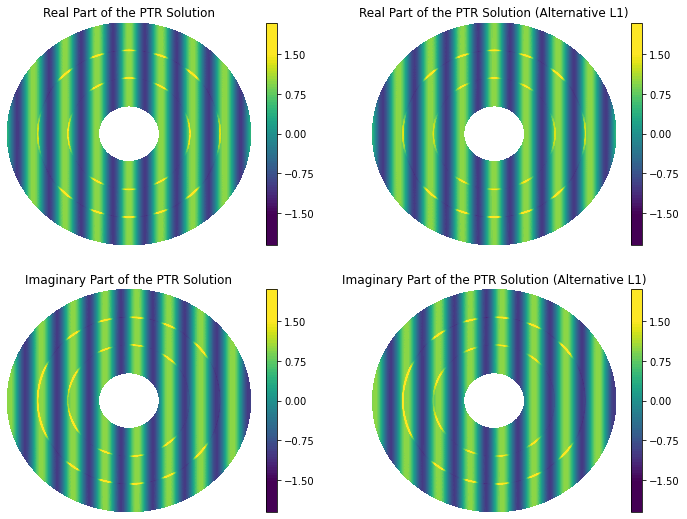

In [15]:
fig = plt.figure(figsize=(12,9))
ax = fig.add_subplot(2, 2, 1)
real1 = plt.contourf(xs, ys, np.real(vs0), 100, cmap=plt.get_cmap('viridis'), vmin=-1.5,vmax=1.5)
#ax.plot(xbdy0, ybdy0, 'r--', zorder=5)
#ax.plot(xbdy1, ybdy1, 'r--', zorder=5)
plt.title("Real Part of the PTR Solution")
fig.colorbar(real1, ticks = [-1.5, -0.75, 0, 0.75, 1.5])
plt.axis('off')

ax = fig.add_subplot(2, 2, 3)
imag1 = plt.contourf(xs, ys, np.imag(vs0), 100, cmap=plt.get_cmap('viridis'), vmin=-1.5,vmax=1.5)
#ax.plot(xbdy0, ybdy0, 'r--', zorder=5)
#ax.plot(xbdy1, ybdy1, 'r--', zorder=5)
plt.title("Imaginary Part of the PTR Solution")
fig.colorbar(imag1, ticks = [-1.5, -0.75, 0, 0.75, 1.5])
plt.axis('off')

ax = fig.add_subplot(2, 2, 2)
real1 = plt.contourf(xs, ys, np.real(vs1), 100, cmap=plt.get_cmap('viridis'), vmin=-1.5,vmax=1.5)
#ax.plot(xbdy0, ybdy0, 'r--', zorder=5)
#ax.plot(xbdy1, ybdy1, 'r--', zorder=5)
plt.title("Real Part of the PTR Solution (Alternative L1)")
fig.colorbar(real1, ticks = [-1.5, -0.75, 0, 0.75, 1.5])
plt.axis('off')

ax = fig.add_subplot(2, 2, 4)
imag1 = plt.contourf(xs, ys, np.imag(vs1), 100, cmap=plt.get_cmap('viridis'), vmin=-1.5,vmax=1.5)
#ax.plot(xbdy0, ybdy0, 'r--', zorder=5)
#ax.plot(xbdy1, ybdy1, 'r--', zorder=5)
plt.title("Imaginary Part of the PTR Solution (Alternative L1)")
fig.colorbar(imag1, ticks = [-1.5, -0.75, 0, 0.75, 1.5])
plt.axis('off')

In [16]:
min_val = np.r_[np.abs(exact0 - v0), np.abs(exact1 - v1), np.abs(exact1 - vinf), np.abs(exact2 - v2)].min()
max_val = np.r_[np.abs(exact0 - v0), np.abs(exact1 - v1), np.abs(exact1 - vinf), np.abs(exact2 - v2)].max()

data= [Surface(x=x0, y=y0, z=np.abs(v0 - exact0), cmin=min_val, cmax=max_val),
       Surface(x=x1, y=y1, z=np.abs(v1 - exact1), cmin=min_val, cmax=max_val), 
        Surface(x=x2, y=y2, z=np.abs(v2 - exact2), cmin=min_val, cmax=max_val)]

layout=dict(xaxis=dict(zeroline=False),
            yaxis=dict(zeroline=False),
            width=500,
            height=500,
            margin=dict(l=50, r=50, b=100, t=100),
           title='Absolute Error', hovermode='closest'
           )
          
figure1=dict(data=data, layout=layout)          
iplot(figure1)

In [17]:
data= [Surface(x=x0, y=y0, z=np.log(np.abs(exact0 - v0)), cmin=-10, cmax=0),
       Surface(x=x1, y=y1, z=np.log(np.abs(exact1 - v1)), cmin=-10, cmax=0), 
        Surface(x=x2, y=y2, z=np.log(np.abs(exact2 - v2)), cmin=-10, cmax=0)]

layout=dict(xaxis=dict(zeroline=False),
            yaxis=dict(zeroline=False),
            width=500,
            height=500,
            margin=dict(l=50, r=50, b=100, t=100),
           title='Log Absolute Error', hovermode='closest'
           )
          
figure2=dict(data=data, layout=layout)          
iplot(figure2)

(-8.0, 8.0, -8.0, 8.0)

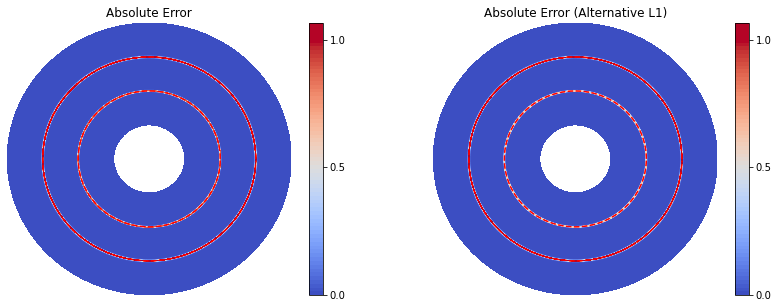

In [18]:
min_val = 0
max_val = 1

fig = plt.figure(figsize=(14,5))
ax = fig.add_subplot(1, 2, 1)
real1 = plt.contourf(xs, ys, np.abs(exacts - vs0), 100, cmap=plt.get_cmap('coolwarm'), vmin=min_val, vmax=max_val)
ax.plot(xbdy0, ybdy0, 'r--', zorder=5)
ax.plot(xbdy1, ybdy1, 'r--', zorder=5)
plt.title("Absolute Error")
fig.colorbar(real1, ticks = [min_val, 0.5 * (max_val - min_val), max_val])
plt.axis('off')

ax = fig.add_subplot(1, 2, 2)
real1 = plt.contourf(xs, ys, np.abs(exacts - vs1), 100, cmap=plt.get_cmap('coolwarm'), vmin=min_val, vmax=max_val)
ax.plot(xbdy0, ybdy0, 'r--', zorder=5)
ax.plot(xbdy1, ybdy1, 'r--', zorder=5)
plt.title("Absolute Error (Alternative L1)")
fig.colorbar(real1, ticks = [min_val, 0.5 * (max_val - min_val), max_val])
plt.axis('off')

(-8.0, 8.0, -8.0, 8.0)

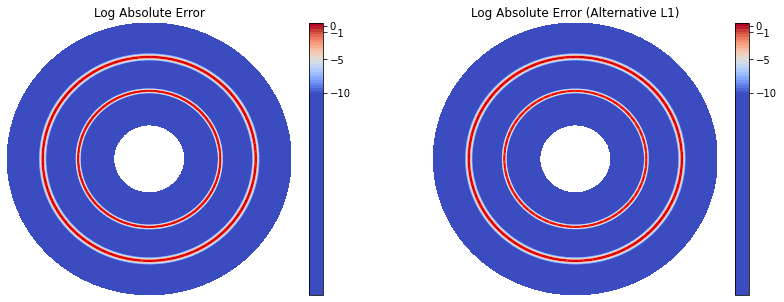

In [19]:
fig = plt.figure(figsize=(14,5))
ax = fig.add_subplot(1, 2, 1)
real1 = plt.contourf(xs, ys, np.log(np.abs(exacts - vs0)), 100, cmap=plt.get_cmap('coolwarm'), vmin=-10, vmax=0)
ax.plot(xbdy0, ybdy0, 'r--', zorder=5)
ax.plot(xbdy1, ybdy1, 'r--', zorder=5)
plt.title("Log Absolute Error")
fig.colorbar(real1, ticks = [-10, -5, -1, 0])
plt.axis('off')

ax = fig.add_subplot(1, 2, 2)
real1 = plt.contourf(xs, ys, np.log(np.abs(exacts - vs1)), 100, cmap=plt.get_cmap('coolwarm'), vmin=-10, vmax=0)
ax.plot(xbdy0, ybdy0, 'r--', zorder=5)
ax.plot(xbdy1, ybdy1, 'r--', zorder=5)
plt.title("Log Absolute Error (Alternative L1)")
fig.colorbar(real1, ticks = [-10, -5, -1, 0])
plt.axis('off')